In [5]:
import pandas as pd
from geopy.geocoders import Nominatim

In [ ]:
from google.colab import files
uploaded = files.upload()

In [ ]:

# Nombre del archivo CSV con múltiples hojas
archivo_csv = "Base_2019.xlsx"

# Leer cada hoja del archivo CSV en un diccionario de DataFrames
diccionario_dataframes = pd.read_excel(archivo_csv, sheet_name=None)

# Iterar a través de las hojas y procesar cada DataFrame
for nombre_hoja, dataframe in diccionario_dataframes.items():
    # Imprimir el nombre de la hoja
    print("Hoja:", nombre_hoja)
    # Imprimir el contenido del DataFrame
    print(dataframe)
    print("-------------------------------------")

Hoja: ACCIDENTES
       idFormulario      Dia      Fecha MES_PROCESADO   Oficina  GravedadCod  \
0                 1    LUNES 2019-01-21         ENERO  11001000            2   
1                 2   MARTES 2019-01-08         ENERO  11001000            3   
2                 3   MARTES 2019-01-01         ENERO  11001000            2   
3                 4   MARTES 2019-01-01         ENERO  11001000            3   
4                 5  VIERNES 2019-01-18         ENERO  11001000            3   
...             ...      ...        ...           ...       ...          ...   
34985         34986    LUNES 2019-12-30     DICIEMBRE  11001000            3   
34986         34987    LUNES 2019-12-30     DICIEMBRE  11001000            3   
34987         34988   MARTES 2019-12-31     DICIEMBRE  11001000            3   
34988         34989   MARTES 2019-12-31     DICIEMBRE  11001000            3   
34989         34990   MARTES 2019-12-31     DICIEMBRE  11001000            2   

      GravedadNombre  

In [ ]:
diccionario_dataframes.keys()

dict_keys(['ACCIDENTES', 'CONDUCTORES', 'VICTIMAS'])

In [ ]:
ACCIDENTES = diccionario_dataframes["ACCIDENTES"]

In [ ]:
ACCIDENTES.shape

(34990, 50)

In [ ]:
ACCIDENTES.head()

,idFormulario,Dia,Fecha,MES_PROCESADO,Oficina,GravedadCod,GravedadNombre,ClaseCodigo,ClaseNombre,ChoqueCodigo,...,CON_CARGA,CON_EMBRIAGUEZ,CON_HUECOS,CON_MENORES,CON_MOTO,CON_PEATON,CON_PERSONA_MAYOR,CON_RUTAS,CON_TPI,CON_VELOCIDAD
0,1,LUNES,2019-01-21,ENERO,11001000,2,Con Heridos,2,Atropello,NaN,...,NO,NO,NO,NO,NO,SI,SI,NO,NO,NO
1,2,MARTES,2019-01-08,ENERO,11001000,3,Solo Daños,1,Choque,1.0,...,NO,NO,NO,NO,SI,NO,SI,NO,NO,NO
2,3,MARTES,2019-01-01,ENERO,11001000,2,Con Heridos,1,Choque,1.0,...,NO,NO,NO,NO,NO,NO,NO,NO,NO,NO
3,4,MARTES,2019-01-01,ENERO,11001000,3,Solo Daños,1,Choque,1.0,...,NO,NO,NO,NO,SI,NO,NO,NO,NO,NO
4,5,VIERNES,2019-01-18,ENERO,11001000,3,Solo Daños,1,Choque,1.0,...,NO,NO,NO,NO,NO,NO,NO,NO,NO,NO


In [ ]:
columnas = []
conteo_valores_unicos = []
valores_unicos = []
tipo_dato= []
conteo_nulos =[]
# Iterar a través de las columnas del DataFrame
for columna in ACCIDENTES.columns:
    valores_unicos_columna = ACCIDENTES[columna].unique()

    columnas.append(columna)
    conteo_valores_unicos.append(len(valores_unicos_columna))
    valores_unicos.append(valores_unicos_columna)
    tipo_dato.append(ACCIDENTES[columna].dtypes)
    conteo_nulos.append(ACCIDENTES[columna].isnull().sum())
informacion_columnas = pd.DataFrame({
    'Campo': columnas,
    'tipo_dato':tipo_dato,
    'Número_Valores_Unicos': conteo_valores_unicos,
    'conteo_nulos':conteo_nulos,
    'Valores_Unicos': valores_unicos
})

informacion_columnas.head(informacion_columnas.shape[0])

,Campo,tipo_dato,Número_Valores_Unicos,conteo_nulos,Valores_Unicos
0,idFormulario,int64,34990,0,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14..."
1,Dia,object,7,0,"[LUNES, MARTES, VIERNES, MIÉRCOLES, JUEVES, DO..."
2,Fecha,datetime64[ns],365,0,"[2019-01-21T00:00:00.000000000, 2019-01-08T00:..."
3,MES_PROCESADO,object,12,0,"[ENERO, FEBRERO, MARZO, ABRIL, AGOSTO, JUNIO, ..."
4,Oficina,int64,1,0,[11001000]
5,GravedadCod,int64,3,0,"[2, 3, 1]"
6,GravedadNombre,object,3,0,"[Con Heridos, Solo Daños, Con Muertos]"
7,ClaseCodigo,int64,6,0,"[2, 1, 4, 3, 6, 5]"
8,ClaseNombre,object,6,0,"[Atropello, Choque, Caida de ocupante, Volcami..."
9,ChoqueCodigo,float64,6,5263,"[nan, 1.0, 5.0, 4.0, 2.0, 3.0]"


In [ ]:
ACCIDENTES["TipoVia1"].unique()

array(['AK', 'KR', 'CL', 'AV', 'TR', 'AC', 'DG'], dtype=object)

In [ ]:
mapeo_reemplazo = {
    'CL': 'Calle',
    'KR': 'Carrera',
    'AV': '',
    'AK': '',
    'TR': 'Transversal',
    'AC': 'Avenida Calle',
    'DG': 'Diagonal'
}

# Reemplazar los valores en la columna 'Direccion'
ACCIDENTES['TipoVia1'] = ACCIDENTES['TipoVia1'].replace(mapeo_reemplazo, regex=True)
ACCIDENTES['TipoVia2'] = ACCIDENTES['TipoVia2'].replace(mapeo_reemplazo, regex=True)

# Imprimir el DataFrame actualizado
print(ACCIDENTES["TipoVia1"].unique())
print(ACCIDENTES["TipoVia2"].unique())

['' 'Carrera' 'Calle' 'Transversal' 'Avenida Calle' 'Diagonal']
['Calle' 'Carrera' 'Transversal' 'Diagonal' 'Avenida Calle' '']


In [ ]:
# Crear la nueva columna 'Direccion' concatenando las columnas requeridas
def convertir_a_str(valor):
    if pd.isnull(valor):
        return ""
    else:
        return str(valor)

# Crear la nueva columna 'Direccion' concatenando las columnas requeridas
ACCIDENTES['Direccion'] = (
    ACCIDENTES['TipoVia1'].apply(convertir_a_str) + ' ' +
    ACCIDENTES['NumeroVia1'].apply(convertir_a_str) +
    ACCIDENTES['LetraVia1'].apply(convertir_a_str) + ' ' +
    #ACCIDENTES['CardinalVia1'].apply(convertir_a_str) + '# ' +
    ACCIDENTES['TipoVia2'].apply(convertir_a_str) + ' ' +
    ACCIDENTES['NumeroVia2'].apply(convertir_a_str) +
    ACCIDENTES['LetraVia2'].apply(convertir_a_str) + ',' +
    #ACCIDENTES['CardinalVia2'].apply(convertir_a_str) + ' ' +
    #ACCIDENTES['Complemento'].apply(convertir_a_str) + ", "+
    ACCIDENTES['Localidad'].apply(convertir_a_str)
)

# Imprimir el DataFrame actualizado con la nueva columna 'Direccion'
print(ACCIDENTES['Direccion'][31])

Carrera 68 Calle 12.0,KENNEDY


In [ ]:
# Imprimir el DataFrame actualizado con la nueva columna 'Direccion'
print(ACCIDENTES['Direccion'][27])

Carrera 33 Calle 44.0,TUNJUELITO


In [ ]:
# Función para limpiar y formatear la dirección
def limpiar_direccion(direccion):
    direccion_limpia = ' '.join(direccion.split())  # Eliminar espacios duplicados o triples
    direccion_limpia = direccion_limpia.replace('.0', '')  # Eliminar ".0"
    return direccion_limpia

# Aplicar la función de limpieza a la columna 'Direccion'
ACCIDENTES['Direccion'] = ACCIDENTES['Direccion'].apply(limpiar_direccion)

# Imprimir el DataFrame actualizado con las direcciones limpias
print(ACCIDENTES['Direccion'])

0                                     10 Calle 11,SANTA FE
1                              Carrera 4 Calle 29,SANTA FE
2                                Calle 78 Carrera 80J,BOSA
3                     Calle 100 Carrera 67A,BARRIOS UNIDOS
4                            AVENIDA DEL SUR Calle 59,BOSA
                               ...                        
34985                     Calle 3 Carrera 30,PUENTE ARANDA
34986                    Calle 17A Carrera 6,SAN CRISTOBAL
34987    AVENIDA CIUDAD DE CALI Avenida Calle 19A,ENGATIVA
34988                       Carrera 24 Calle 49,TUNJUELITO
34989               Diagonal 69F Carrera 48,CIUDAD BOLIVAR
Name: Direccion, Length: 34990, dtype: object


In [ ]:
pd.set_option('display.max_columns', None)

In [ ]:
ACCIDENTES.head()

,idFormulario,Dia,Fecha,MES_PROCESADO,Oficina,GravedadCod,GravedadNombre,ClaseCodigo,ClaseNombre,ChoqueCodigo,ChoqueNombre,ObjetoFijoCodigo,ObjetoFijoNombre,OtraClase,NombreOtraClase,Latitud,Longitud,Direccion,TipoVia1,NumeroVia1,LetraVia1,CardinalVia1,TipoVia2,NumeroVia2,LetraVia2,CardinalVia2,Complemento,Municipio,Localidad,FechaOcurrencia,HoraOcurrencia,HORA_PROCESADA,Area,Sector,Zona,TipoDisenno,TipoTiempo,ZonaTransito,AreaTransito,CON_BICICLETA,CON_CARGA,CON_EMBRIAGUEZ,CON_HUECOS,CON_MENORES,CON_MOTO,CON_PEATON,CON_PERSONA_MAYOR,CON_RUTAS,CON_TPI,CON_VELOCIDAD
0,1,LUNES,2019-01-21,ENERO,11001000,2,Con Heridos,2,Atropello,NaN,NaN,NaN,NaN,NaN,NaN,4.600165,-74.078109,"10 Calle 11,SANTA FE",,10,NaN,NaN,Calle,11.0,NaN,NaN,2,BOGOTA D.C.,SANTA FE,2019-01-21,22:10,22,22:40,1,3,0,Interseccion,ZONA 4,AREA 9,NO,NO,NO,NO,NO,NO,SI,SI,NO,NO,NO
1,2,MARTES,2019-01-08,ENERO,11001000,3,Solo Daños,1,Choque,1.0,Vehiculo,NaN,NaN,NaN,NaN,4.614745,-74.065600,"Carrera 4 Calle 29,SANTA FE",Carrera,4,NaN,NaN,Calle,29.0,NaN,NaN,2,BOGOTA D.C.,SANTA FE,2019-01-08,19:20,19,19:50,1,1,0,Interseccion,ZONA 4,AREA 9,NO,NO,NO,NO,NO,SI,NO,SI,NO,NO,NO
2,3,MARTES,2019-01-01,ENERO,11001000,2,Con Heridos,1,Choque,1.0,Vehiculo,NaN,NaN,NaN,NaN,4.610391,-74.204815,"Calle 78 Carrera 80J,BOSA",Calle,78,NaN,S,Carrera,80.0,J,NaN,2,BOGOTA D.C.,BOSA,2019-01-01,09:45,9,10:10,1,1,0,Tramo de Via,ZONA 3,AREA 7,SI,NO,NO,NO,NO,NO,NO,NO,NO,NO,NO
3,4,MARTES,2019-01-01,ENERO,11001000,3,Solo Daños,1,Choque,1.0,Vehiculo,NaN,NaN,NaN,NaN,4.688914,-74.072067,"Calle 100 Carrera 67A,BARRIOS UNIDOS",Calle,100,NaN,NaN,Carrera,67.0,A,NaN,2,BOGOTA D.C.,BARRIOS UNIDOS,2019-01-01,11:30,11,11:30,1,3,0,Tramo de Via,ZONA 1,AREA 4,NO,NO,NO,NO,NO,SI,NO,NO,NO,NO,NO
4,5,VIERNES,2019-01-18,ENERO,11001000,3,Solo Daños,1,Choque,1.0,Vehiculo,NaN,NaN,NaN,NaN,4.596987,-74.177981,"AVENIDA DEL SUR Calle 59,BOSA",,AVENIDA DEL SUR,NaN,NaN,Calle,59.0,NaN,NaN,2,BOGOTA D.C.,BOSA,2019-01-18,16:50,16,16:58,1,1,3,Interseccion,ZONA 3,AREA 7,NO,NO,NO,NO,NO,NO,NO,NO,NO,NO,NO


In [ ]:
ACCIDENTES_PRUEBA = ACCIDENTES.copy()
ACCIDENTES_PRUEBA.shape

(34990, 50)

In [ ]:
filas_con_latitud_nula = ACCIDENTES_PRUEBA.loc[ACCIDENTES_PRUEBA['Latitud'].isnull()]
filas_con_latitud_nula.shape

(1007, 50)

In [ ]:
import pandas as pd
import numpy as np
from difflib import SequenceMatcher  # Para calcular similitud de cadenas

# Función para calcular la similitud de direcciones
def similar(a, b):
    return SequenceMatcher(None, a, b).ratio()

# Función para realizar interpolación espacial basada en similitud de dirección
def interpolate_missing_coordinates(dataframe, neighbors=2):
    for index, row in dataframe.iterrows():
        if np.isnan(row["Latitud"]) or np.isnan(row["Longitud"]):
            coordinates_known = dataframe[~(dataframe["Latitud"].isnull() | dataframe["Longitud"].isnull())]
            known_coords = coordinates_known[["Latitud", "Longitud"]].values

            # Calcular similitud de dirección y seleccionar vecinos cercanos
            similarity_scores = [similar(row["Direccion"], known_dir) for known_dir in coordinates_known["Direccion"]]
            closest_indices = np.argsort(similarity_scores, axis=0)[-neighbors:]
            closest_coordinates = coordinates_known.iloc[closest_indices]

            # Calcular ponderación basada en similitud y realizar interpolación
            weights = np.array(similarity_scores)[closest_indices]
            estimated_lat = np.average(closest_coordinates["Latitud"], weights=weights)
            estimated_lon = np.average(closest_coordinates["Longitud"], weights=weights)

            dataframe.at[index, "Latitud"] = estimated_lat
            dataframe.at[index, "Longitud"] = estimated_lon
    return dataframe

# Llama a la función para llenar los valores faltantes de latitud y longitud
ACCIDENTES_PRUEBA = interpolate_missing_coordinates(ACCIDENTES_PRUEBA)



In [ ]:
ACCIDENTES_PRUEBA.head(50)

,idFormulario,Dia,Fecha,MES_PROCESADO,Oficina,GravedadCod,GravedadNombre,ClaseCodigo,ClaseNombre,ChoqueCodigo,ChoqueNombre,ObjetoFijoCodigo,ObjetoFijoNombre,OtraClase,NombreOtraClase,Latitud,Longitud,Direccion,TipoVia1,NumeroVia1,LetraVia1,CardinalVia1,TipoVia2,NumeroVia2,LetraVia2,CardinalVia2,Complemento,Municipio,Localidad,FechaOcurrencia,HoraOcurrencia,HORA_PROCESADA,Area,Sector,Zona,TipoDisenno,TipoTiempo,ZonaTransito,AreaTransito,CON_BICICLETA,CON_CARGA,CON_EMBRIAGUEZ,CON_HUECOS,CON_MENORES,CON_MOTO,CON_PEATON,CON_PERSONA_MAYOR,CON_RUTAS,CON_TPI,CON_VELOCIDAD
0,1,LUNES,2019-01-21,ENERO,11001000,2,Con Heridos,2,Atropello,NaN,NaN,NaN,NaN,NaN,NaN,4.600165,-74.078109,"10 Calle 11,SANTA FE",,10,NaN,NaN,Calle,11.0,NaN,NaN,2,BOGOTA D.C.,SANTA FE,2019-01-21,22:10,22,22:40,1,3,0,Interseccion,ZONA 4,AREA 9,NO,NO,NO,NO,NO,NO,SI,SI,NO,NO,NO
1,2,MARTES,2019-01-08,ENERO,11001000,3,Solo Daños,1,Choque,1.0,Vehiculo,NaN,NaN,NaN,NaN,4.614745,-74.065600,"Carrera 4 Calle 29,SANTA FE",Carrera,4,NaN,NaN,Calle,29.0,NaN,NaN,2,BOGOTA D.C.,SANTA FE,2019-01-08,19:20,19,19:50,1,1,0,Interseccion,ZONA 4,AREA 9,NO,NO,NO,NO,NO,SI,NO,SI,NO,NO,NO
2,3,MARTES,2019-01-01,ENERO,11001000,2,Con Heridos,1,Choque,1.0,Vehiculo,NaN,NaN,NaN,NaN,4.610391,-74.204815,"Calle 78 Carrera 80J,BOSA",Calle,78,NaN,S,Carrera,80.0,J,NaN,2,BOGOTA D.C.,BOSA,2019-01-01,09:45,9,10:10,1,1,0,Tramo de Via,ZONA 3,AREA 7,SI,NO,NO,NO,NO,NO,NO,NO,NO,NO,NO
3,4,MARTES,2019-01-01,ENERO,11001000,3,Solo Daños,1,Choque,1.0,Vehiculo,NaN,NaN,NaN,NaN,4.688914,-74.072067,"Calle 100 Carrera 67A,BARRIOS UNIDOS",Calle,100,NaN,NaN,Carrera,67.0,A,NaN,2,BOGOTA D.C.,BARRIOS UNIDOS,2019-01-01,11:30,11,11:30,1,3,0,Tramo de Via,ZONA 1,AREA 4,NO,NO,NO,NO,NO,SI,NO,NO,NO,NO,NO
4,5,VIERNES,2019-01-18,ENERO,11001000,3,Solo Daños,1,Choque,1.0,Vehiculo,NaN,NaN,NaN,NaN,4.596987,-74.177981,"AVENIDA DEL SUR Calle 59,BOSA",,AVENIDA DEL SUR,NaN,NaN,Calle,59.0,NaN,NaN,2,BOGOTA D.C.,BOSA,2019-01-18,16:50,16,16:58,1,1,3,Interseccion,ZONA 3,AREA 7,NO,NO,NO,NO,NO,NO,NO,NO,NO,NO,NO
5,6,MIÉRCOLES,2019-01-23,ENERO,11001000,2,Con Heridos,1,Choque,1.0,Vehiculo,NaN,NaN,NaN,NaN,4.544526,-74.135927,"AVENIDA BOYACA Calle 72,USME",,AVENIDA BOYACA,NaN,NaN,Calle,72.0,NaN,S,2,BOGOTA D.C.,USME,2019-01-23,09:15,9,09:25,1,1,0,Tramo de Via,ZONA 2,AREA 11,NO,NO,NO,NO,NO,SI,NO,NO,NO,NO,NO
6,7,MIÉRCOLES,2019-01-16,ENERO,11001000,3,Solo Daños,1,Choque,1.0,Vehiculo,NaN,NaN,NaN,NaN,4.680250,-74.057858,"Carrera 45 Calle 93,BARRIOS UNIDOS",Carrera,45,NaN,NaN,Calle,93.0,NaN,NaN,2,BOGOTA D.C.,BARRIOS UNIDOS,2019-01-16,11:10,11,11:25,1,1,3,Tramo de Via,ZONA 1,AREA 4,NO,SI,NO,NO,NO,NO,NO,SI,NO,NO,NO
7,8,VIERNES,2019-01-04,ENERO,11001000,2,Con Heridos,1,Choque,1.0,Vehiculo,NaN,NaN,NaN,NaN,4.719159,-74.052684,"Carrera 45A Calle 134,SUBA",Carrera,45,A,NaN,Calle,134.0,NaN,NaN,2,BOGOTA D.C.,SUBA,2019-01-04,05:00,5,05:45,1,1,0,Interseccion,ZONA 1,AREA 3,NO,NO,NO,NO,NO,NO,NO,SI,NO,NO,NO
8,9,JUEVES,2019-01-10,ENERO,11001000,2,Con Heridos,2,Atropello,NaN,NaN,NaN,NaN,NaN,NaN,4.626400,-74.102500,"AVENIDA DE LAS AMERICAS Carrera 45,PUENTE ARANDA",,AVENIDA DE LAS AMERICAS,NaN,NaN,Carrera,45.0,NaN,NaN,2,BOGOTA D.C.,PUENTE ARANDA,2019-01-10,08:50,8,09:15,1,3,0,Tramo de Via,ZONA 4,AREA 8,NO,NO,NO,NO,NO,SI,SI,NO,NO,NO,NO
9,10,MIÉRCOLES,2019-02-06,FEBRERO,11001000,3,Solo Daños,1,Choque,1.0,Vehiculo,NaN,NaN,NaN,NaN,4.622845,-74.092971,"Calle 19 Carrera 36,PUENTE ARANDA",Calle,19,NaN,NaN,Carrera,36.0,NaN,NaN,2,BOGOTA D.C.,PUENTE ARANDA,2019-02-06,22:10,22,22:40,1,2,0,Tramo de Via,ZONA 4,AREA 8,NO,NO,NO,NO,NO,NO,NO,NO,NO,SI,NO


In [ ]:
filas_con_latitud_nula = ACCIDENTES_PRUEBA.loc[ACCIDENTES_PRUEBA['Latitud'].isnull()]
filas_con_latitud_nula.shape

(0, 50)

In [ ]:
ACCIDENTES_PRUEBA.shape

(34990, 50)

In [ ]:
columnas = []
conteo_valores_unicos = []
valores_unicos = []
tipo_dato= []
conteo_nulos =[]
# Iterar a través de las columnas del DataFrame
for columna in ACCIDENTES_PRUEBA.columns:
    valores_unicos_columna = ACCIDENTES_PRUEBA[columna].unique()

    columnas.append(columna)
    conteo_valores_unicos.append(len(valores_unicos_columna))
    valores_unicos.append(valores_unicos_columna)
    tipo_dato.append(ACCIDENTES_PRUEBA[columna].dtypes)
    conteo_nulos.append(ACCIDENTES_PRUEBA[columna].isnull().sum())
informacion_columnas = pd.DataFrame({
    'Campo': columnas,
    'tipo_dato':tipo_dato,
    'Número_Valores_Unicos': conteo_valores_unicos,
    'conteo_nulos':conteo_nulos,
    'Valores_Unicos': valores_unicos
})

informacion_columnas.head(informacion_columnas.shape[0])

,Campo,tipo_dato,Número_Valores_Unicos,conteo_nulos,Valores_Unicos
0,idFormulario,int64,34990,0,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14..."
1,Dia,object,7,0,"[LUNES, MARTES, VIERNES, MIÉRCOLES, JUEVES, DO..."
2,Fecha,datetime64[ns],365,0,"[2019-01-21T00:00:00.000000000, 2019-01-08T00:..."
3,MES_PROCESADO,object,12,0,"[ENERO, FEBRERO, MARZO, ABRIL, AGOSTO, JUNIO, ..."
4,Oficina,int64,1,0,[11001000]
5,GravedadCod,int64,3,0,"[2, 3, 1]"
6,GravedadNombre,object,3,0,"[Con Heridos, Solo Daños, Con Muertos]"
7,ClaseCodigo,int64,6,0,"[2, 1, 4, 3, 6, 5]"
8,ClaseNombre,object,6,0,"[Atropello, Choque, Caida de ocupante, Volcami..."
9,ChoqueCodigo,float64,6,5263,"[nan, 1.0, 5.0, 4.0, 2.0, 3.0]"


In [ ]:
!pip install openpyxl

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
# Guardar el DataFrame en un archivo Excel
nombre_archivo = "ACCIDENTES_PRUEBA.xlsx"
ACCIDENTES_PRUEBA.to_excel(nombre_archivo, index=False)

print(f"DataFrame guardado en '{nombre_archivo}'")

DataFrame guardado en 'ACCIDENTES_PRUEBA.xlsx'


In [3]:
from google.colab import files
uploaded = files.upload()

Saving Base_accidentes.xlsx to Base_accidentes.xlsx


In [8]:
ACCIDENTES_V1 = pd.read_excel("Base_accidentes.xlsx")
ACCIDENTES_V1.head()

,idFormulario,Dia,Fecha,MES_PROCESADO,Oficina,GravedadCod,GravedadNombre,ClaseCodigo,ClaseNombre,ChoqueCodigo,...,CON_CARGA,CON_EMBRIAGUEZ,CON_HUECOS,CON_MENORES,CON_MOTO,CON_PEATON,CON_PERSONA_MAYOR,CON_RUTAS,CON_TPI,CON_VELOCIDAD
0,1,LUNES,2019-01-21,ENERO,11001000,2,Con Heridos,2,Atropello,NaN,...,NO,NO,NO,NO,NO,SI,SI,NO,NO,NO
1,2,MARTES,2019-01-08,ENERO,11001000,3,Solo Daños,1,Choque,1.0,...,NO,NO,NO,NO,SI,NO,SI,NO,NO,NO
2,3,MARTES,2019-01-01,ENERO,11001000,2,Con Heridos,1,Choque,1.0,...,NO,NO,NO,NO,NO,NO,NO,NO,NO,NO
3,4,MARTES,2019-01-01,ENERO,11001000,3,Solo Daños,1,Choque,1.0,...,NO,NO,NO,NO,SI,NO,NO,NO,NO,NO
4,5,VIERNES,2019-01-18,ENERO,11001000,3,Solo Daños,1,Choque,1.0,...,NO,NO,NO,NO,NO,NO,NO,NO,NO,NO


In [10]:
ACCIDENTES_V1.shape

(34990, 50)

In [55]:
# Se procede a seleccionar columnas para realizar la descripción y analisis de la información
ACCIDENTES_VF = ACCIDENTES_V1[['idFormulario', 'MES_PROCESADO', 'GravedadNombre','ClaseNombre','Latitud','Longitud','HoraOcurrencia','TipoTiempo','CON_BICICLETA', 'CON_CARGA', 'CON_EMBRIAGUEZ', 'CON_HUECOS', 'CON_MENORES', 'CON_MOTO', 'CON_PEATON', 'CON_PERSONA_MAYOR', 'CON_RUTAS', 'CON_TPI', 'CON_VELOCIDAD']].copy()
ACCIDENTES_VF.head()

,idFormulario,MES_PROCESADO,GravedadNombre,ClaseNombre,Latitud,Longitud,HoraOcurrencia,TipoTiempo,CON_BICICLETA,CON_CARGA,CON_EMBRIAGUEZ,CON_HUECOS,CON_MENORES,CON_MOTO,CON_PEATON,CON_PERSONA_MAYOR,CON_RUTAS,CON_TPI,CON_VELOCIDAD
0,1,ENERO,Con Heridos,Atropello,4.600165,-74.078109,22:10,Interseccion,NO,NO,NO,NO,NO,NO,SI,SI,NO,NO,NO
1,2,ENERO,Solo Daños,Choque,4.614745,-74.065600,19:20,Interseccion,NO,NO,NO,NO,NO,SI,NO,SI,NO,NO,NO
2,3,ENERO,Con Heridos,Choque,4.610391,-74.204815,09:45,Tramo de Via,SI,NO,NO,NO,NO,NO,NO,NO,NO,NO,NO
3,4,ENERO,Solo Daños,Choque,4.688914,-74.072067,11:30,Tramo de Via,NO,NO,NO,NO,NO,SI,NO,NO,NO,NO,NO
4,5,ENERO,Solo Daños,Choque,4.596987,-74.177981,16:50,Interseccion,NO,NO,NO,NO,NO,NO,NO,NO,NO,NO,NO


In [56]:
ACCIDENTES_VF.shape

(34990, 19)

In [26]:
columnas = []
conteo_valores_unicos = []
valores_unicos = []
tipo_dato= []
conteo_nulos =[]
# Iterar a través de las columnas del DataFrame
for columna in ACCIDENTES_VF.columns:
    valores_unicos_columna = ACCIDENTES_VF[columna].unique()

    columnas.append(columna)
    conteo_valores_unicos.append(len(valores_unicos_columna))
    valores_unicos.append(valores_unicos_columna)
    tipo_dato.append(ACCIDENTES_VF[columna].dtypes)
    conteo_nulos.append(ACCIDENTES_VF[columna].isnull().sum())
informacion_columnas = pd.DataFrame({
    'Campo': columnas,
    'tipo_dato':tipo_dato,
    'Número_Valores_Unicos': conteo_valores_unicos,
    'conteo_nulos':conteo_nulos,
    'Valores_Unicos': valores_unicos
})

informacion_columnas.head(informacion_columnas.shape[0])

,Campo,tipo_dato,Número_Valores_Unicos,conteo_nulos,Valores_Unicos
0,idFormulario,int64,34990,0,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14..."
1,MES_PROCESADO,object,12,0,"[ENERO, FEBRERO, MARZO, ABRIL, AGOSTO, JUNIO, ..."
2,GravedadNombre,object,3,0,"[Con Heridos, Solo Daños, Con Muertos]"
3,ClaseNombre,object,6,0,"[Atropello, Choque, Caida de ocupante, Volcami..."
4,ChoqueNombre,object,6,5263,"[nan, Vehiculo, Otro, Objeto Fijo, Tren, Semov..."
5,Latitud,float64,21358,0,"[4.60016516, 4.61474486, 4.61039096, 4.6889143..."
6,Longitud,float64,21297,0,"[-74.07810854, -74.06559998, -74.20481494, -74..."
7,Localidad,object,20,0,"[SANTA FE, BOSA, BARRIOS UNIDOS, USME, SUBA, P..."
8,HoraOcurrencia,object,1391,0,"[22:10, 19:20, 09:45, 11:30, 16:50, 09:15, 11:..."
9,TipoTiempo,object,11,0,"[Interseccion, Tramo de Via, Glorieta, Puente,..."


In [14]:
!pip install folium pandas

In [16]:
import folium
from folium.plugins import HeatMap

In [21]:
# Crear un mapa centrado en Bogotá
mapa_bogota = folium.Map(location=[4.6097, -74.0817], zoom_start=12)

# Crea una lista de coordenadas a partir de las columnas Latitud y Longitud
coordenadas = ACCIDENTES_VF[['Latitud', 'Longitud']].values

# Itera sobre las filas del DataFrame y agrega marcadores de círculo para cada punto
for index, row in ACCIDENTES_VF.iterrows():
    latitud = row['Latitud']
    longitud = row['Longitud']
    folium.CircleMarker([latitud, longitud], radius=1, color='blue', fill=True).add_to(mapa_bogota)

# Muestra el mapa directamente en la celda de Colab
mapa_bogota

In [22]:
# Itera sobre las filas del DataFrame y agrega marcadores de círculo para cada punto
for index, row in ACCIDENTES_VF.iterrows():
    latitud = row['Latitud']
    longitud = row['Longitud']
    folium.CircleMarker([latitud, longitud], radius=1, color='blue', fill=True).add_to(mapa_bogota)

# Muestra el mapa directamente en la celda de Colab
mapa_bogota

In [ ]:
# Obtén los valores únicos de la columna "ClaseNombre"
clases = ACCIDENTES_VF['ClaseNombre'].unique()

# Crea un diccionario para almacenar los mapas por clase
mapas_por_clase = {}

# Itera sobre las clases y crea un mapa para cada una
for clase in clases:
    # Filtra el DataFrame por la clase actual
    datos_clase = ACCIDENTES_VF[ACCIDENTES_VF['ClaseNombre'] == clase]

    # Crea un mapa centrado en Bogotá
    mapa_clase = folium.Map(location=[4.6097, -74.0817], zoom_start=12)

    # Itera sobre las filas del DataFrame de la clase actual y agrega marcadores de círculo
    for index, row in datos_clase.iterrows():
        latitud = row['Latitud']
        longitud = row['Longitud']
        folium.CircleMarker([latitud, longitud], radius=1, color='blue', fill=True).add_to(mapa_clase)

    # Almacena el mapa en el diccionario
    mapas_por_clase[clase] = mapa_clase

# Muestra los mapas por clase
for clase, mapa in mapas_por_clase.items():
    print(f"Mapa para la clase '{clase}':")
    display(mapa)

In [29]:
import matplotlib.pyplot as plt

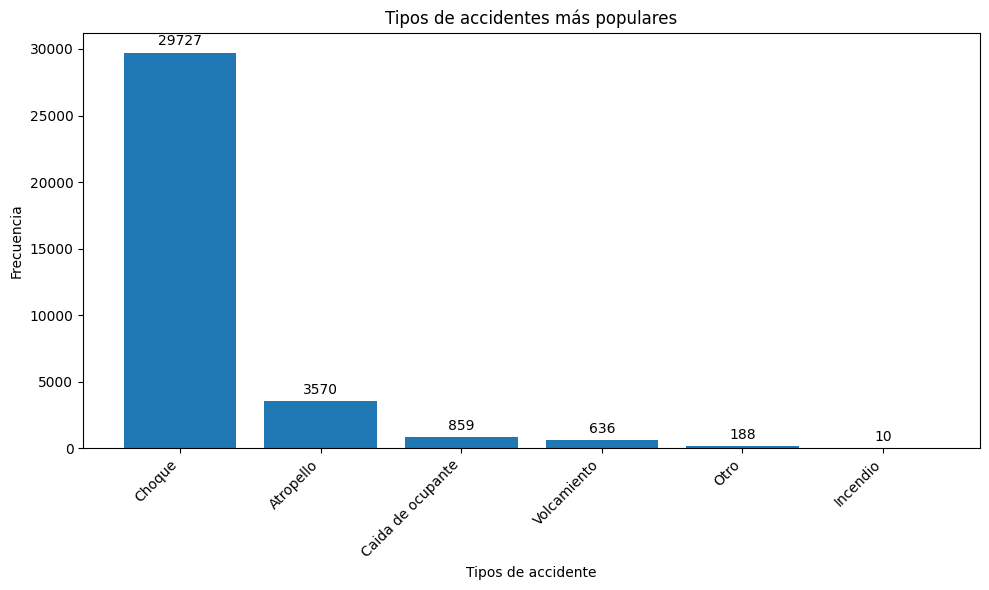

In [41]:
# Obtener la cuenta de valores únicos en la columna 'ClaseNombre'
conteo_valores = ACCIDENTES_VF['ClaseNombre'].value_counts()

# Crear una figura y ejes para el gráfico de barras apiladas
fig, ax = plt.subplots(figsize=(10, 6))

# Crear el gráfico de barras apiladas
bars = ax.bar(conteo_valores.index, conteo_valores, label='Tipos de accidente')

# Personalizar el gráfico
ax.set_xlabel('Tipos de accidente')
ax.set_ylabel('Frecuencia')
ax.set_title('Tipos de accidentes más populares')

# Rotar las etiquetas del eje x para una mejor legibilidad
plt.xticks(rotation=45, ha='right')

# Agregar los valores en el centro de las barras
for bar in bars:
    height = bar.get_height()
    ax.annotate('{}'.format(height),
                xy=(bar.get_x() + bar.get_width() / 2, height),
                xytext=(0, 3),  # 3 puntos arriba de la barra
                textcoords="offset points",
                ha='center', va='bottom')

# Mostrar el gráfico
plt.tight_layout()
plt.show()

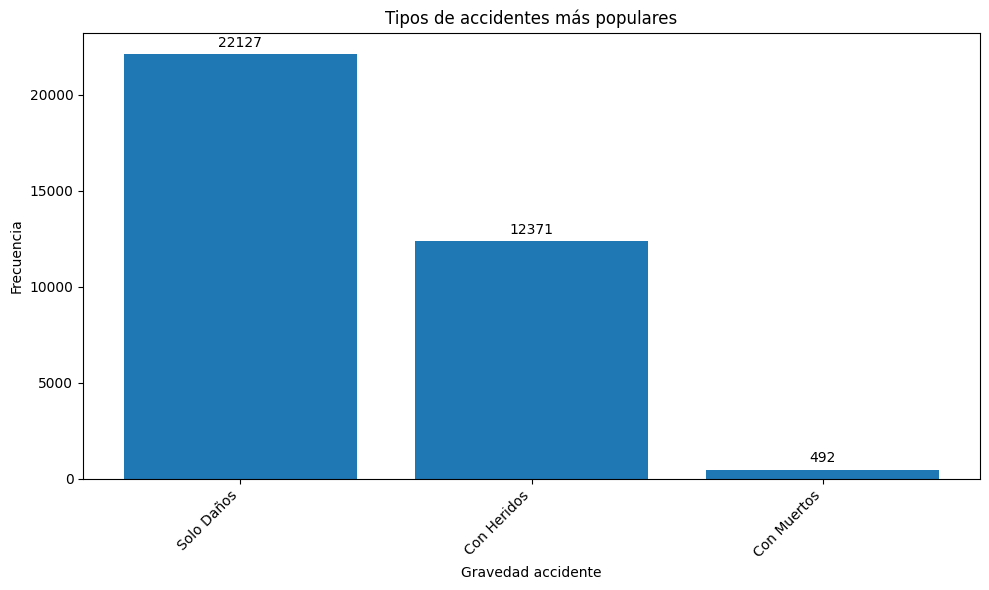

In [42]:
# Obtener la cuenta de valores únicos en la columna 'ClaseNombre'
conteo_valores = ACCIDENTES_VF['GravedadNombre'].value_counts()

# Crear una figura y ejes para el gráfico de barras apiladas
fig, ax = plt.subplots(figsize=(10, 6))

# Crear el gráfico de barras apiladas
bars = ax.bar(conteo_valores.index, conteo_valores, label='gravedad accidente')

# Personalizar el gráfico
ax.set_xlabel('Gravedad accidente')
ax.set_ylabel('Frecuencia')
ax.set_title('Gravedad de los accidentes')

# Rotar las etiquetas del eje x para una mejor legibilidad
plt.xticks(rotation=45, ha='right')

# Agregar los valores en el centro de las barras
for bar in bars:
    height = bar.get_height()
    ax.annotate('{}'.format(height),
                xy=(bar.get_x() + bar.get_width() / 2, height),
                xytext=(0, 3),  # 3 puntos arriba de la barra
                textcoords="offset points",
                ha='center', va='bottom')

# Mostrar el gráfico
plt.tight_layout()
plt.show()

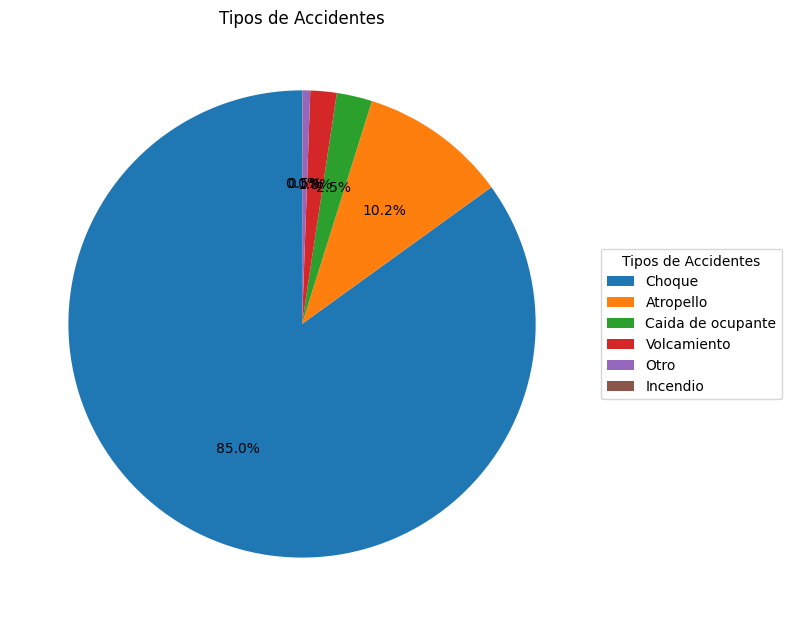

In [49]:
# Obtener la cuenta de valores únicos en la columna 'ClaseNombre'
conteo_valores = ACCIDENTES_VF['ClaseNombre'].value_counts()

# Crear una figura y ejes para el gráfico de torta
fig, ax = plt.subplots(figsize=(8, 8))

# Crear el gráfico de torta con el formato personalizado (solo porcentajes)
pie = ax.pie(conteo_valores, labels=None, autopct='%1.1f%%', startangle=90)

# Personalizar el gráfico
ax.set_title('Tipos de Accidentes')

# Agregar una leyenda
ax.legend(conteo_valores.index, title="Tipos de Accidentes", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))

# Mostrar el gráfico
plt.tight_layout()
plt.show()

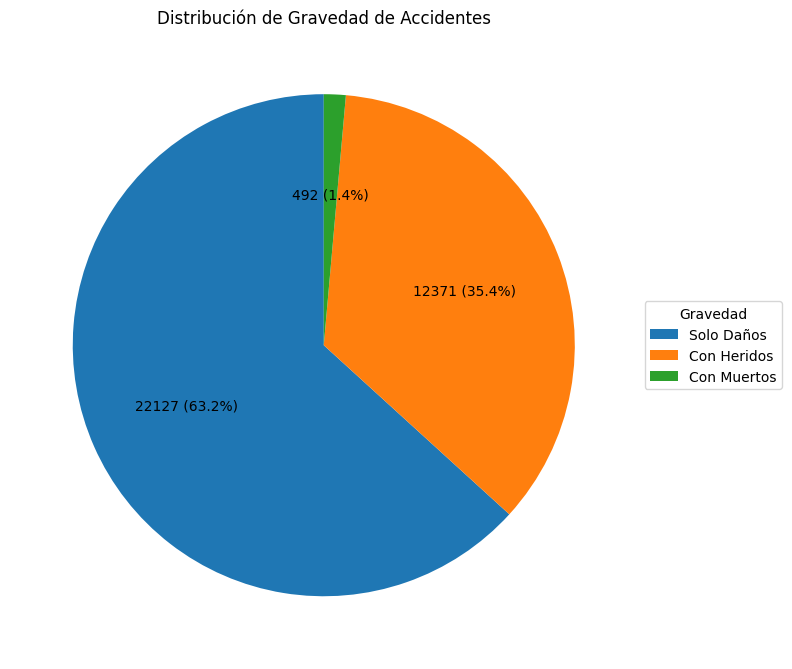

In [45]:
# Obtener la cuenta de valores únicos en la columna 'GravedadNombre'
conteo_valores = ACCIDENTES_VF['GravedadNombre'].value_counts()

# Crear una figura y ejes para el gráfico de torta
fig, ax = plt.subplots(figsize=(8, 8))

# Crear el gráfico de torta con el formato personalizado
pie = ax.pie(conteo_valores, labels=None, autopct=lambda p: '{:.0f} ({:.1f}%)'.format(p * sum(conteo_valores) / 100, p), startangle=90)

# Personalizar el gráfico
ax.set_title('Distribución de Gravedad de Accidentes')

# Agregar una leyenda
ax.legend(conteo_valores.index, title="Gravedad", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))

# Mostrar el gráfico
plt.tight_layout()
plt.show()

In [52]:
!pip install pandas_profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 5.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 357.3/357.3 kB 9.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 19.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 10.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 24.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 15.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 40.1 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=bfd90a467caba3a33b02bdef26fe57633311a941446c566c64e921441f6e93ae
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attempting uninstall: pydantic
    Found existing installation: pydantic 2.2.1
    Uninstalling pydantic-2.

In [53]:
from pandas_profiling import ProfileReport

<ipython-input-53-e2a33329b6f0>:1: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


In [57]:
profile = ProfileReport(ACCIDENTES_VF)



# To save the report as an HTML file
#profile.to_file("data_profile_report.html")



# To display the report in a Jupyter Notebook
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]